In [1]:
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
import pandas as pd
import mlflow
from sklearn.model_selection import ParameterGrid
from numba import cuda

import os
import gc
import glob
import shutil
from typing import Iterable

import modelVAE
import trainVAE

2025-02-12 07:30:02.525048: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1739334602.747527    1137 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1739334602.810888    1137 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-02-12 07:30:03.543090: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
IMG_FOLDER : str = r"/mnt/c/Users/User/Desktop/datasets/CelebA/img_align_celeba/"
BATCH_SIZE : int = 80
SIZE : tuple[int] = (128, 128)

In [3]:
mlflow.set_experiment("VAE_Hyperparameter_Tuning")

# Create a DataFrame to store results
results_df = pd.DataFrame(columns=['model_name', 'latent_dim', 'learning_rate', 'epochs', 'train_loss', 'val_loss'])

I0000 00:00:1739334624.437308    1137 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 2246 MB memory:  -> device: 0, name: NVIDIA GeForce GTX 1650, pci bus id: 0000:09:00.0, compute capability: 7.5


Epoch 1/10


I0000 00:00:1739334630.581959    2208 service.cc:148] XLA service 0x7f34140041e0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1739334630.582695    2208 service.cc:156]   StreamExecutor device (0): NVIDIA GeForce GTX 1650, Compute Capability 7.5
2025-02-12 07:30:30.712729: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1739334631.185737    2208 cuda_dnn.cc:529] Loaded cuDNN version 90300
I0000 00:00:1739334641.256083    2208 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


2533/2533 ━━━━━━━━━━━━━━━━━━━━ 411s 157ms/step - kl_loss: 140.0292 - loss: 11046.8633 - reconstruction_loss: 10906.8398 - learning_rate: 0.0010
Epoch 2/10
2533/2533 ━━━━━━━━━━━━━━━━━━━━ 426s 154ms/step - kl_loss: 134.6243 - loss: 8724.5859 - reconstruction_loss: 8589.9600 - learning_rate: 0.0010
Epoch 3/10
2533/2533 ━━━━━━━━━━━━━━━━━━━━ 391s 154ms/step - kl_loss: 144.1300 - loss: 8523.4307 - reconstruction_loss: 8379.2998 - learning_rate: 0.0010
Epoch 4/10
2533/2533 ━━━━━━━━━━━━━━━━━━━━ 391s 154ms/step - kl_loss: 146.8746 - loss: 8424.1230 - reconstruction_loss: 8277.2510 - learning_rate: 0.0010
Epoch 5/10
2533/2533 ━━━━━━━━━━━━━━━━━━━━ 390s 154ms/step - kl_loss: 149.1862 - loss: 8368.6104 - reconstruction_loss: 8219.4248 - learning_rate: 0.0010
Epoch 6/10
2533/2533 ━━━━━━━━━━━━━━━━━━━━ 397s 157ms/step - kl_loss: 151.3421 - loss: 8322.6445 - reconstruction_loss: 8171.3008 - learning_rate: 0.0010
Epoch 7/10
2533/2533 ━━━━━━━━━━━━━━━━━━━━ 397s 156ms/step - kl_loss: 152.8687 - loss: 8297.

2025-02-12 10:48:33.807329: W external/local_xla/xla/tsl/framework/bfc_allocator.cc:497] Allocator (GPU_0_bfc) ran out of memory trying to allocate 32.00MiB (rounded to 33554432)requested by op 
2025-02-12 10:48:33.809152: I external/local_xla/xla/tsl/framework/bfc_allocator.cc:1053] BFCAllocator dump for GPU_0_bfc
2025-02-12 10:48:33.809206: I external/local_xla/xla/tsl/framework/bfc_allocator.cc:1060] Bin (256): 	Total Chunks: 228176, Chunks in use: 228176. 55.71MiB allocated for chunks. 55.71MiB in use in bin. 899.9KiB client-requested in use in bin.
2025-02-12 10:48:33.809217: I external/local_xla/xla/tsl/framework/bfc_allocator.cc:1060] Bin (512): 	Total Chunks: 65, Chunks in use: 65. 32.8KiB allocated for chunks. 32.8KiB in use in bin. 29.8KiB client-requested in use in bin.
2025-02-12 10:48:33.809222: I external/local_xla/xla/tsl/framework/bfc_allocator.cc:1060] Bin (1024): 	Total Chunks: 26, Chunks in use: 26. 26.8KiB allocated for chunks. 26.8KiB in use in bin. 26.0KiB client-

ResourceExhaustedError: Graph execution error:

Detected at node StatefulPartitionedCall defined at (most recent call last):
  File "/usr/lib/python3.10/runpy.py", line 196, in _run_module_as_main

  File "/usr/lib/python3.10/runpy.py", line 86, in _run_code

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/ipykernel_launcher.py", line 18, in <module>

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/traitlets/config/application.py", line 1075, in launch_instance

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/ipykernel/kernelapp.py", line 739, in start

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/tornado/platform/asyncio.py", line 205, in start

  File "/usr/lib/python3.10/asyncio/base_events.py", line 603, in run_forever

  File "/usr/lib/python3.10/asyncio/base_events.py", line 1909, in _run_once

  File "/usr/lib/python3.10/asyncio/events.py", line 80, in _run

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/ipykernel/kernelbase.py", line 545, in dispatch_queue

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/ipykernel/kernelbase.py", line 534, in process_one

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/ipykernel/kernelbase.py", line 437, in dispatch_shell

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/ipykernel/ipkernel.py", line 362, in execute_request

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/ipykernel/kernelbase.py", line 778, in execute_request

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/ipykernel/ipkernel.py", line 449, in do_execute

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/ipykernel/zmqshell.py", line 549, in run_cell

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/IPython/core/interactiveshell.py", line 3077, in run_cell

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/IPython/core/interactiveshell.py", line 3132, in _run_cell

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/IPython/core/async_helpers.py", line 128, in _pseudo_sync_runner

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/IPython/core/interactiveshell.py", line 3336, in run_cell_async

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/IPython/core/interactiveshell.py", line 3519, in run_ast_nodes

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/IPython/core/interactiveshell.py", line 3579, in run_code

  File "/tmp/ipykernel_1137/1887566466.py", line 24, in <module>

  File "/home/nasser/projects/test/trainVAE.py", line 101, in train

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/keras/src/utils/traceback_utils.py", line 117, in error_handler

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/keras/src/backend/tensorflow/trainer.py", line 368, in fit

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/keras/src/backend/tensorflow/trainer.py", line 216, in function

  File "/home/nasser/projects/test/.venv/lib/python3.10/site-packages/keras/src/backend/tensorflow/trainer.py", line 129, in multi_step_on_iterator

Out of memory while trying to allocate 33554432 bytes.
BufferAssignment OOM Debugging.
BufferAssignment stats:
             parameter allocation:  319.34MiB
              constant allocation:         0B
        maybe_live_out allocation:  304.34MiB
     preallocated temp allocation:    1.42GiB
  preallocated temp fragmentation:       124B (0.00%)
                 total allocation:    1.73GiB
              total fragmentation:   34.64MiB (1.96%)
Peak buffers:
	Buffer 1:
		Size: 160.00MiB
		XLA Label: fusion
		Shape: f32[80,32,128,128]
		==========================

	Buffer 2:
		Size: 160.00MiB
		Operator: op_type="Conv2D" op_name="StatefulPartitionedCall/gradient_tape/decoder_1/conv2d_transpose_4_1/conv_transpose/Conv2D" source_file="/home/nasser/projects/test/.venv/lib/python3.10/site-packages/tensorflow/python/framework/ops.py" source_line=1196
		XLA Label: custom-call
		Shape: f32[80,32,128,128]
		==========================

	Buffer 3:
		Size: 160.00MiB
		Operator: op_type="Conv2DBackpropInput" op_name="StatefulPartitionedCall/decoder_1/conv2d_transpose_3_1/conv_transpose" source_file="/home/nasser/projects/test/.venv/lib/python3.10/site-packages/tensorflow/python/framework/ops.py" source_line=1196
		XLA Label: custom-call
		Shape: f32[80,32,128,128]
		==========================

	Buffer 4:
		Size: 160.00MiB
		Operator: op_type="Relu" op_name="encoder_1/conv2d_1/Relu;StatefulPartitionedCall/encoder_1/conv2d_1/Relu"
		XLA Label: fusion
		Shape: f32[80,32,128,128]
		==========================

	Buffer 5:
		Size: 160.00MiB
		Operator: op_type="Conv2D" op_name="StatefulPartitionedCall/encoder_1/conv2d_1/convolution" source_file="/home/nasser/projects/test/.venv/lib/python3.10/site-packages/tensorflow/python/framework/ops.py" source_line=1196
		XLA Label: custom-call
		Shape: f32[80,32,128,128]
		==========================

	Buffer 6:
		Size: 80.00MiB
		Operator: op_type="Relu" op_name="decoder_1/conv2d_transpose_2_1/Relu;StatefulPartitionedCall/decoder_1/conv2d_transpose_2_1/Relu"
		XLA Label: fusion
		Shape: f32[80,64,64,64]
		==========================

	Buffer 7:
		Size: 80.00MiB
		Operator: op_type="Conv2DBackpropInput" op_name="StatefulPartitionedCall/decoder_1/conv2d_transpose_2_1/conv_transpose" source_file="/home/nasser/projects/test/.venv/lib/python3.10/site-packages/tensorflow/python/framework/ops.py" source_line=1196
		XLA Label: custom-call
		Shape: f32[80,64,64,64]
		==========================

	Buffer 8:
		Size: 80.00MiB
		Operator: op_type="Relu" op_name="encoder_1/conv2d_1_2/Relu;StatefulPartitionedCall/encoder_1/conv2d_1_2/Relu"
		XLA Label: fusion
		Shape: f32[80,64,64,64]
		==========================

	Buffer 9:
		Size: 80.00MiB
		Operator: op_type="Conv2D" op_name="StatefulPartitionedCall/encoder_1/conv2d_1_2/convolution" source_file="/home/nasser/projects/test/.venv/lib/python3.10/site-packages/tensorflow/python/framework/ops.py" source_line=1196
		XLA Label: custom-call
		Shape: f32[80,64,64,64]
		==========================

	Buffer 10:
		Size: 40.00MiB
		Operator: op_type="Relu" op_name="decoder_1/conv2d_transpose_1_2/Relu;StatefulPartitionedCall/decoder_1/conv2d_transpose_1_2/Relu"
		XLA Label: fusion
		Shape: f32[80,128,32,32]
		==========================

	Buffer 11:
		Size: 40.00MiB
		Operator: op_type="Conv2DBackpropInput" op_name="StatefulPartitionedCall/decoder_1/conv2d_transpose_1_2/conv_transpose" source_file="/home/nasser/projects/test/.venv/lib/python3.10/site-packages/tensorflow/python/framework/ops.py" source_line=1196
		XLA Label: custom-call
		Shape: f32[80,128,32,32]
		==========================

	Buffer 12:
		Size: 40.00MiB
		Operator: op_type="Relu" op_name="encoder_1/conv2d_2_1/Relu;StatefulPartitionedCall/encoder_1/conv2d_2_1/Relu"
		XLA Label: fusion
		Shape: f32[80,128,32,32]
		==========================

	Buffer 13:
		Size: 40.00MiB
		Operator: op_type="Conv2D" op_name="StatefulPartitionedCall/encoder_1/conv2d_2_1/convolution" source_file="/home/nasser/projects/test/.venv/lib/python3.10/site-packages/tensorflow/python/framework/ops.py" source_line=1196
		XLA Label: custom-call
		Shape: f32[80,128,32,32]
		==========================

	Buffer 14:
		Size: 32.00MiB
		XLA Label: fusion
		Shape: f32[32768,256]
		==========================

	Buffer 15:
		Size: 32.00MiB
		XLA Label: fusion
		Shape: f32[32768,256]
		==========================


	 [[{{node StatefulPartitionedCall}}]]
Hint: If you want to see a list of allocated tensors when OOM happens, add report_tensor_allocations_upon_oom to RunOptions for current allocation info. This isn't available when running in Eager mode.
 [Op:__inference_multi_step_on_iterator_1770175]

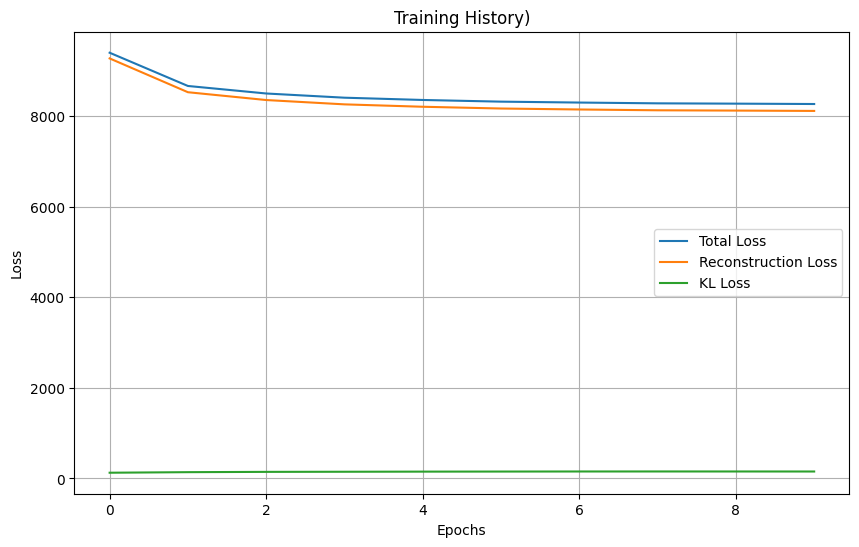

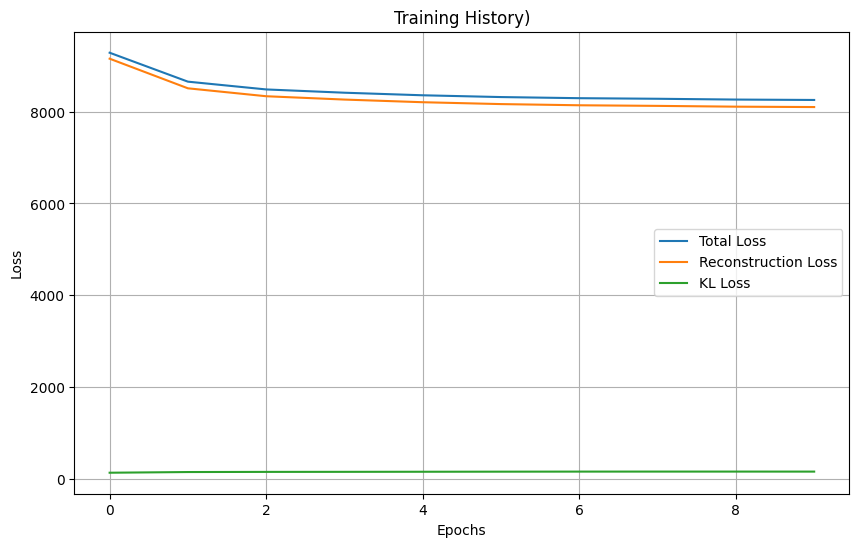

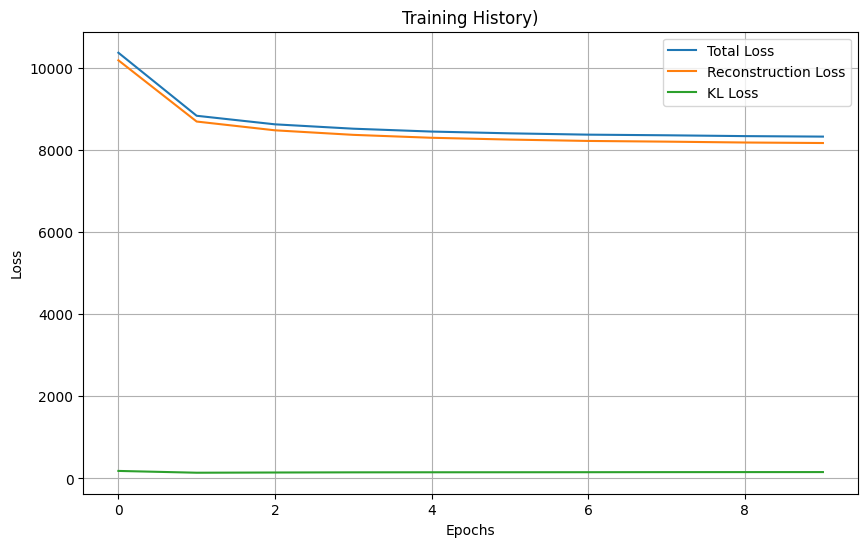

In [4]:
param_grid = {
    'latent_dim': [16, 64, 128, 256],
    'learning_rate': [0.001, 0.0005, 0.0001],
    'epochs': [20, 30],
}

device = cuda.get_current_device()

for params in ParameterGrid(param_grid):
    with mlflow.start_run():
        # Log latent dimension
        mlflow.log_params(params)
        
        IMG_FOLDER : str = r"/mnt/c/Users/User/Desktop/datasets/CelebA/img_align_celeba/"

        # Create and train the VAE model
        encoder = modelVAE.encoder(params['latent_dim'])
        decoder = modelVAE.decoder(params['latent_dim'])
        vae = modelVAE.VAE(encoder, decoder)
        
        attempt_name = f'latent{params["latent_dim"]}_lr{params["learning_rate"]}_epochs{params["epochs"]}'
        
        data = trainVAE.dataSetGenerator(IMG_FOLDER, BATCH_SIZE)
        [loss, reconstruction_loss, kl_loss] = trainVAE.train(vae, 
                                                              data, 
                                                              params['learning_rate'],
                                                              batch_size=BATCH_SIZE,
                                                              name=attempt_name,
                                                              epochs=params['epochs'])

        # Log metrics
        mlflow.log_metrics({"loss": loss[-1], "reconstruction_loss": reconstruction_loss[-1], "kl_loss": kl_loss[-1]})
        
        results_df.update({
            'model_name': attempt_name,
            'latent_dim': params['latent_dim'],
            'learning_rate': params['learning_rate'],
            'epochs': params['epochs'],
            'loss': loss,
            'reconstruction_loss': reconstruction_loss,
            'kl_loss': kl_loss,
        })
        # Save results
        
        del vae, encoder, decoder, data  # Delete the model
        tf.keras.backend.clear_session()  # Clear the TensorFlow graph
        gc.collect() 

        
    
results_df.to_csv('vae_hyperparameter_tuning_results.csv', index=False)
print("Hyperparameter tuning completed. Results saved to 'vae_hyperparameter_tuning_results.csv'.")